Download data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from sklearn.preprocessing import LabelEncoder

df = pd.read_csv("../clean_data.csv")

# Display the first few rows of the dataset to understand its structure
df.head()

,Unnamed: 0,ID,Price (billion VND),Area (m2),Property Type,Bedrooms,Bathrooms,Address,Law Document,Post Date,Latitude,Longitude,Postal Code,Importance,Place Rank,City
0,0,ABC118222,1.77,54.10,Apartment,2,1,"Số 4, Phong Phú, Bình Chánh",Valid Documents,2024-09-11,10.714894,106.640598,72900.0,0.000067,30.0,HCM
1,1,A01198772,20.00,104.00,Apartment,2,2,"Nguyễn Thị Minh Khai, Bến Nghé, Quận 1",Valid Documents,2024-08-30,10.770974,106.702470,71010.0,0.053400,26.0,HCM
2,2,A0289931,18.00,91.57,Apartment,2,2,"Mai Chí Thọ, Thủ Thiêm, Quận 2",Valid Documents,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,HCM
3,3,A0287287,10.50,63.94,Apartment,1,1,"Mai Chí Thọ, Thủ Thiêm, Quận 2",Valid Documents,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,HCM
4,4,A02198668,16.50,92.30,Apartment,2,2,"Mai Chí Thọ, Thủ Thiêm, Quận 2",Valid Documents,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,HCM


Step 1: Overview and Initial Checks

In [12]:
# Dataset shape: Check the number of rows and columns
print(f"Dataset Shape: {df.shape}")

# Display basic info: Get data types, non-null values, etc.
df.info()

# Describe the numerical columns to get an overview of the distributions
df.describe()

# Describe non-numerical columns for unique value count
df.describe(include='object')


Dataset Shape: (28409, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28409 entries, 0 to 28408
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Unnamed: 0           28409 non-null  int64  
 1   ID                   28409 non-null  object 
 2   Price (billion VND)  28409 non-null  float64
 3   Area (m2)            28409 non-null  float64
 4   Property Type        28409 non-null  object 
 5   Bedrooms             28409 non-null  int64  
 6   Bathrooms            28409 non-null  int64  
 7   Address              28409 non-null  object 
 8   Law Document         28409 non-null  object 
 9   Post Date            28409 non-null  object 
 10  Latitude             28409 non-null  float64
 11  Longitude            28409 non-null  float64
 12  Postal Code          28409 non-null  float64
 13  Importance           28409 non-null  float64
 14  Place Rank           28409 non-null  float64
 15  City     

,ID,Property Type,Address,Law Document,Post Date,City
count,28409,28409,28409,28409,28409,28409
unique,28409,4,6345,5,1910,2
top,ABC118222,Apartment,"Nguyễn Hữu Cảnh, Phường 22, Bình Thạnh",Valid Documents,2019-05-16,HN
freq,1,10447,353,21972,281,21124


Step 2: Data Types and Conversions

In [13]:
# Convert Post Date to datetime type
df['Post Date'] = pd.to_datetime(df['Post Date'], format='%Y-%m-%d')

# Encoding categorical features
label_encoder = LabelEncoder()
for column in ['Property Type', 'Law Document', 'City']:
    df[column] = label_encoder.fit_transform(df[column])


# Step 3: Remove outliers

In [14]:
# Filter the dataset to exclude properties with extreme values for Price and Area
filtered_df = df[(df['Price (billion VND)'] <= 2000) & (df['Area (m2)'] <= 20000) & (df['Area (m2)'] > 0)]
df = filtered_df
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28404 entries, 0 to 28408
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Unnamed: 0           28404 non-null  int64         
 1   ID                   28404 non-null  object        
 2   Price (billion VND)  28404 non-null  float64       
 3   Area (m2)            28404 non-null  float64       
 4   Property Type        28404 non-null  int32         
 5   Bedrooms             28404 non-null  int64         
 6   Bathrooms            28404 non-null  int64         
 7   Address              28404 non-null  object        
 8   Law Document         28404 non-null  int32         
 9   Post Date            28404 non-null  datetime64[ns]
 10  Latitude             28404 non-null  float64       
 11  Longitude            28404 non-null  float64       
 12  Postal Code          28404 non-null  float64       
 13  Importance           28404 non-null 

In [15]:
df

,Unnamed: 0,ID,Price (billion VND),Area (m2),Property Type,Bedrooms,Bathrooms,Address,Law Document,Post Date,Latitude,Longitude,Postal Code,Importance,Place Rank,City
0,0,ABC118222,1.77,54.10,0,2,1,"Số 4, Phong Phú, Bình Chánh",4,2024-09-11,10.714894,106.640598,72900.0,0.000067,30.0,0
1,1,A01198772,20.00,104.00,0,2,2,"Nguyễn Thị Minh Khai, Bến Nghé, Quận 1",4,2024-08-30,10.770974,106.702470,71010.0,0.053400,26.0,0
2,2,A0289931,18.00,91.57,0,2,2,"Mai Chí Thọ, Thủ Thiêm, Quận 2",4,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,0
3,3,A0287287,10.50,63.94,0,1,1,"Mai Chí Thọ, Thủ Thiêm, Quận 2",4,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,0
4,4,A02198668,16.50,92.30,0,2,2,"Mai Chí Thọ, Thủ Thiêm, Quận 2",4,2024-08-04,10.774573,106.724893,72806.0,0.053400,26.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28404,28404,36069,15.50,75.00,1,7,2,"29, Thanh Trung, Trau Quy, Gia Lam, Ha Noi, TT...",3,2024-05-13,21.006650,105.945238,10000.0,0.053406,26.0,1
28405,28405,36070,0.25,134.00,1,6,4,"Tan Mai, Tan Mai, Hoang Mai, Ha Noi",3,2024-06-02,20.983219,105.858281,11617.0,0.053406,26.0,1
28406,28406,36073,22.00,100.00,1,3,2,"Pho Đoi Can, Đoi Can, Ba Đinh, Ha Noi",3,2024-06-12,21.035370,105.819214,10229.0,0.000073,30.0,1
28407,28407,36078,20.00,75.00,1,2,3,"Nguyen XIen, Đai Kim, Hoang Mai, Ha Noi",3,2024-08-09,20.979245,105.812054,10135.0,0.053406,26.0,1


Step 4: Outlier Detection

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


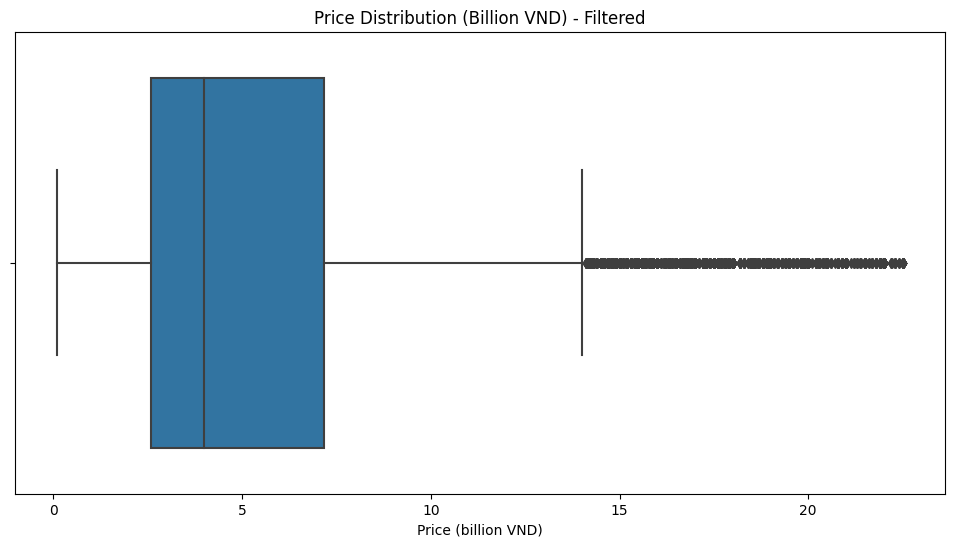

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


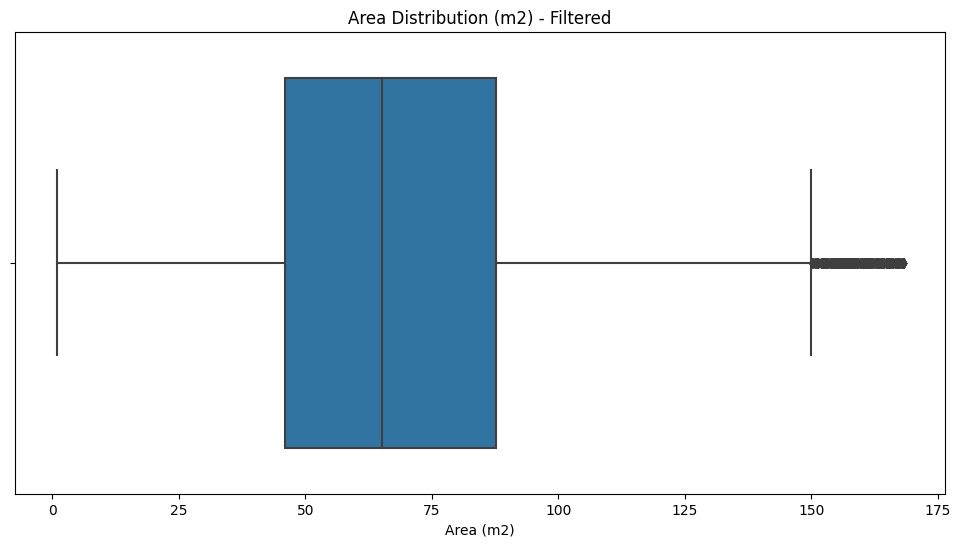

In [16]:
# Step 4: Outlier Detection

# Boxplot for Price (filtered) to identify outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='Price (billion VND)')
plt.title('Price Distribution (Billion VND) - Filtered')
plt.xlabel('Price (billion VND)')
plt.show()

# Boxplot for Area (filtered) to identify outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='Area (m2)')
plt.title('Area Distribution (m2) - Filtered')
plt.xlabel('Area (m2)')
plt.show()

Step 5: Distribution of Important Features

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


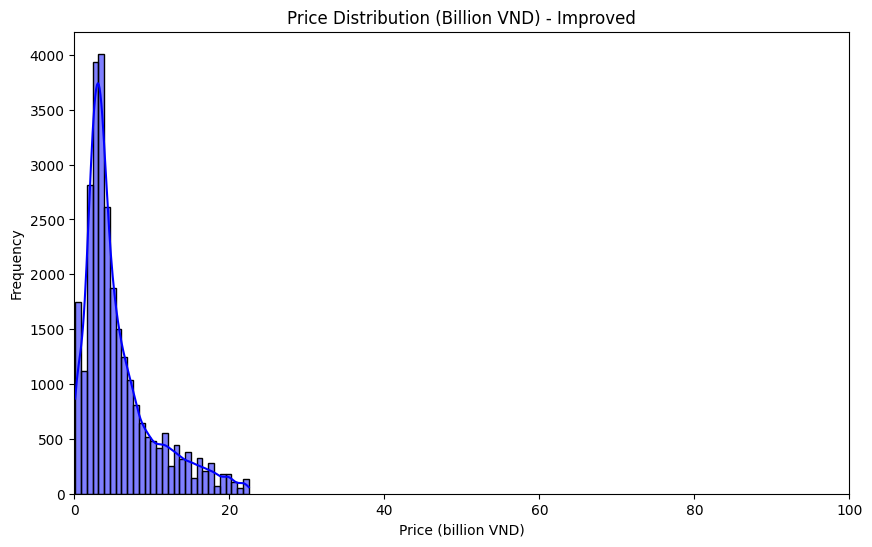

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


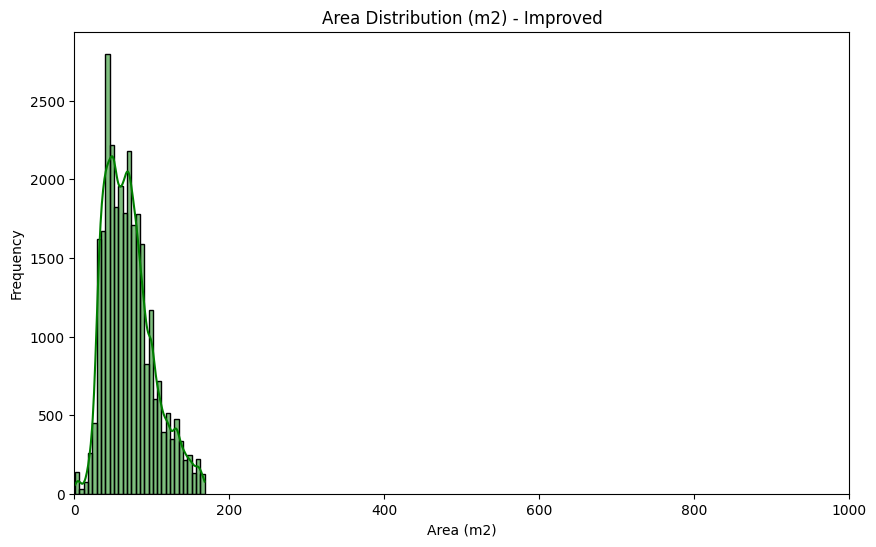

In [17]:
# Step 5: Distribution of Important Features

# Filter data for more visually appealing histograms
price_filtered_hist = df[df['Price (billion VND)'] <= 100]
area_filtered_hist = df[df['Area (m2)'] <= 1000]

# Histogram for Price (billion VND) - Improved Visualization
plt.figure(figsize=(10, 6))
sns.histplot(price_filtered_hist['Price (billion VND)'], bins=30, kde=True, color='blue')
plt.title('Price Distribution (Billion VND) - Improved')
plt.xlabel('Price (billion VND)')
plt.ylabel('Frequency')
plt.xlim(0, 100)
plt.show()

# Histogram for Area (m2) - Improved Visualization
plt.figure(figsize=(10, 6))
sns.histplot(area_filtered_hist['Area (m2)'], bins=30, kde=True, color='green')
plt.title('Area Distribution (m2) - Improved')
plt.xlabel('Area (m2)')
plt.ylabel('Frequency')
plt.xlim(0, 1000)
plt.show()

Step 6: Geographical Insights

In [18]:
import folium
from folium.plugins import MarkerCluster

# Strip whitespace from column names
df.columns = df.columns.str.strip()

# Check column names to verify correctness
print(df.columns)

# Create a map centered around Vietnam with restricted view to prevent dragging too far out
map_vietnam = folium.Map(location=[14.0583, 108.2772], zoom_start=6, max_bounds=True)
map_vietnam.fit_bounds([[8.179, 102.144], [23.393, 114.333]])  # Setting bounds around Vietnam
marker_cluster = MarkerCluster().add_to(map_vietnam)

# Add markers for each property using the original DataFrame
for idx, row in df.iterrows():
    if 'Latitude' in df.columns and 'Longitude' in df.columns:
        if not pd.isna(row['Latitude']) and not pd.isna(row['Longitude']):
            popup_text = (
                f"Price: {row['Price (billion VND)']} billion VND\n"
                f"Area: {row['Area (m2)']} m2\n"
                f"Bedrooms: {row['Bedrooms']}\n"
                f"Bathrooms: {row['Bathrooms']}\n"
                f"Property Type: {row['Property Type']}\n"
                f"Law Document: {row['Law Document']}\n"
                f"Importance: {row['Importance']}\n"
                f"Place Rank: {row['Place Rank']}\n"
            )
            folium.Marker(location=[row['Latitude'], row['Longitude']],
                          popup=popup_text).add_to(marker_cluster)

# Display the map
map_vietnam


Index(['Unnamed: 0', 'ID', 'Price (billion VND)', 'Area (m2)', 'Property Type',
       'Bedrooms', 'Bathrooms', 'Address', 'Law Document', 'Post Date',
       'Latitude', 'Longitude', 'Postal Code', 'Importance', 'Place Rank',
       'City'],
      dtype='object')


Step 7: Correlation Analysis

In [19]:
# # Filter the DataFrame to include only numeric columns and drop rows with NaN values
# numeric_df = df.select_dtypes(include=[np.number]).dropna()

# # Heatmap for correlation among numerical features
# plt.figure(figsize=(8, 6))
# sns.heatmap(numeric_df.corr(), annot=True, cmap='coolwarm')
# plt.title('Correlation Heatmap')
# plt.show()

# # Filter the DataFrame to include only rows with valid numeric values for the selected columns
# filtered_df = df[['Price (billion VND)', 'Area (m2)', 'Bedrooms', 'Bathrooms', 'Importance', 'Place Rank']].dropna()

# # Pairplot of the filtered DataFrame
# sns.pairplot(filtered_df)
# plt.show()

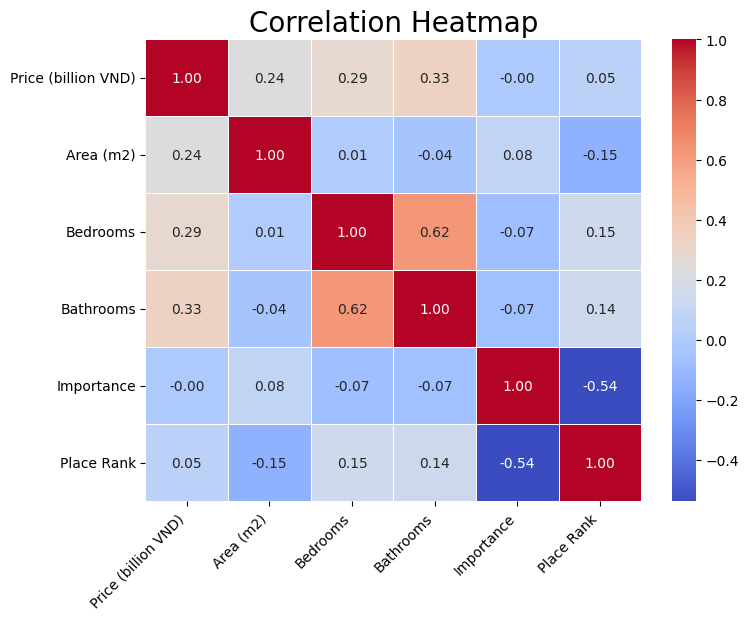

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is 

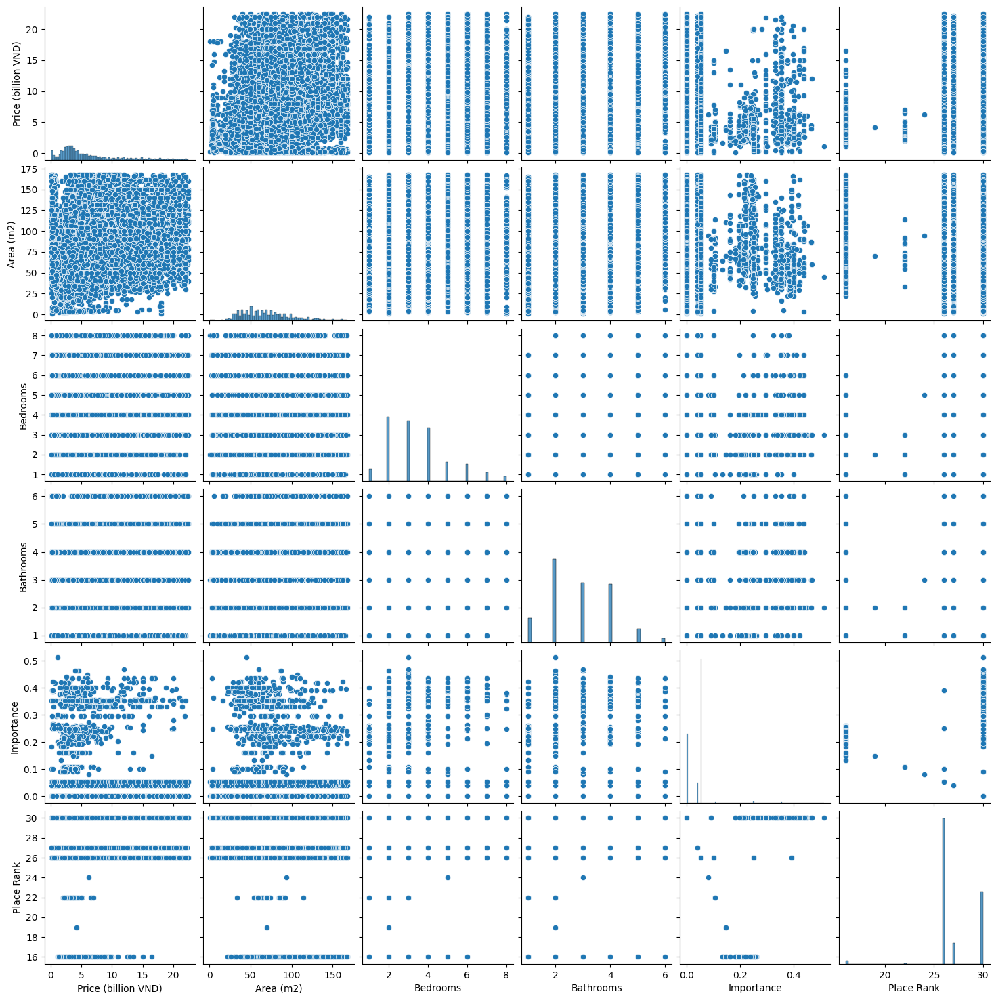

In [20]:
df_cor = df.drop(df.columns[0], axis=1)
for col in df_cor.columns:
    if df_cor[col].dtype == 'object':
        try:
            df_cor[col] = pd.to_numeric(df_cor[col], errors='ignore')
        except (ValueError, TypeError):
            pass

correlation_matrix = df_cor.select_dtypes(include=['number']).drop(columns=['Unnamed', 'Postal Code','Latitude', 'Longitude', 'City', 'Law Document', 'Property Type'], errors='ignore').corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Heatmap', fontsize=20)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.show()

# Filter the DataFrame to include only rows with valid numeric values for the selected columns
filtered_df = df[['Price (billion VND)', 'Area (m2)', 'Bedrooms', 'Bathrooms', 'Importance', 'Place Rank']].dropna()

# Pairplot of the filtered DataFrame
sns.pairplot(filtered_df)
plt.show()

Step 8: Analyzing Property Types

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


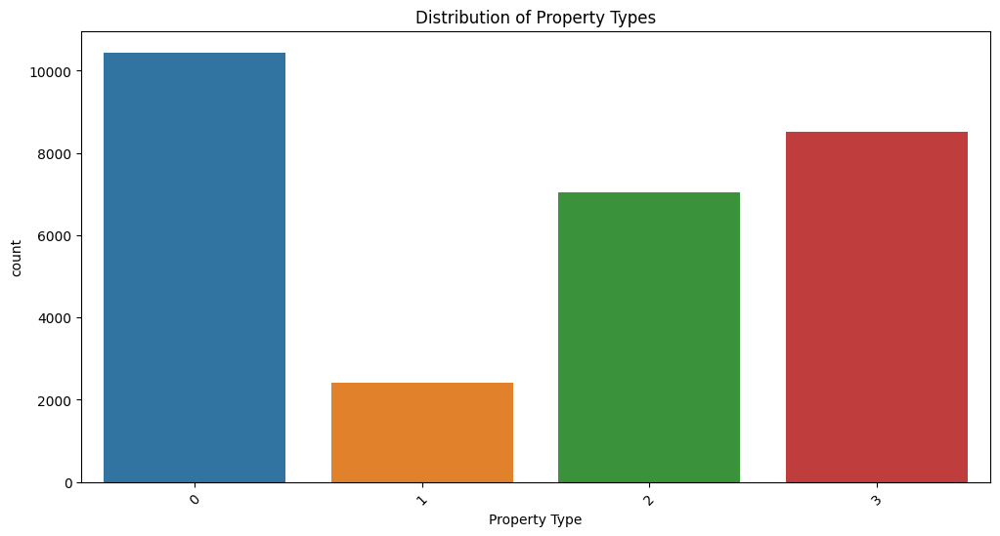

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


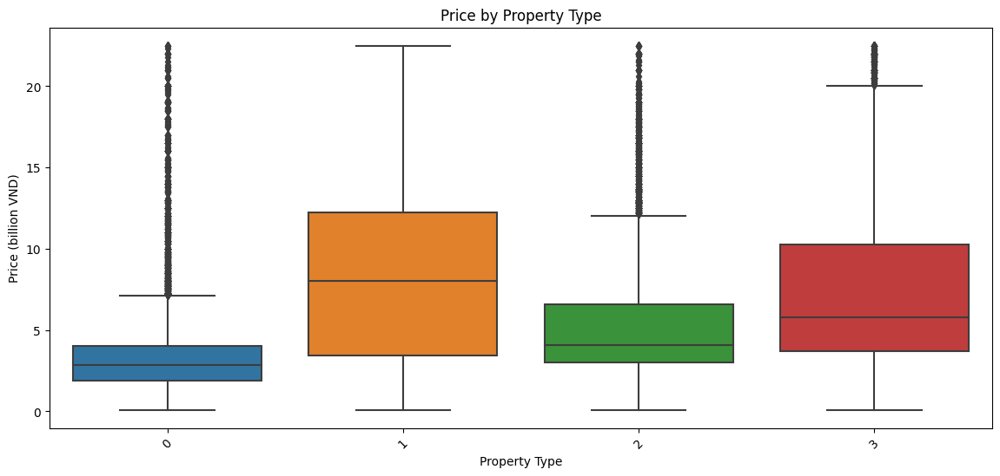

In [21]:
# Count plot for Property Type
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='Property Type')
plt.title('Distribution of Property Types')
plt.xticks(rotation=45)
plt.show()

# Relationship between Property Type and Price
plt.figure(figsize=(14, 6))
sns.boxplot(data=df, x='Property Type', y='Price (billion VND)')
plt.title('Price by Property Type')
plt.xticks(rotation=45)
plt.show()


Step 9: Law Document Impact

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


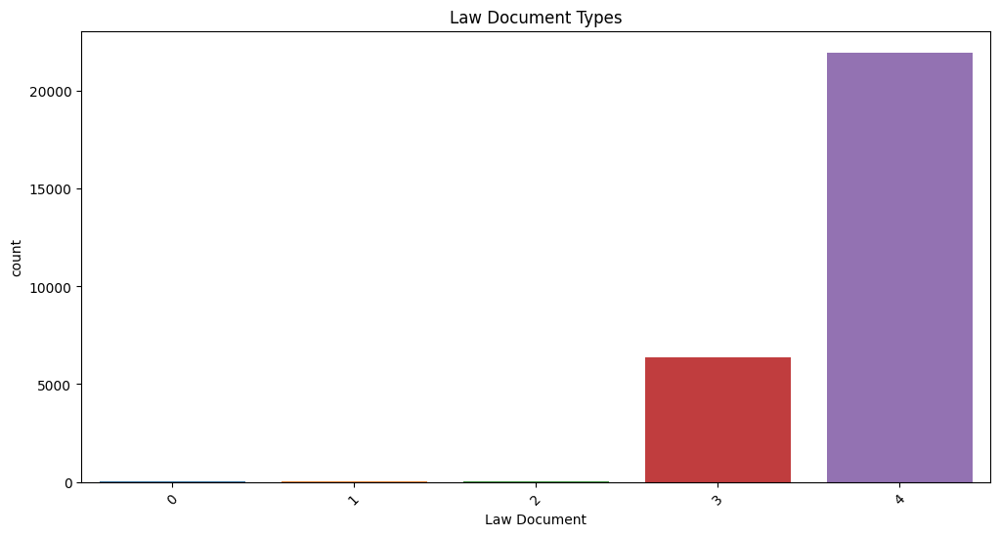

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


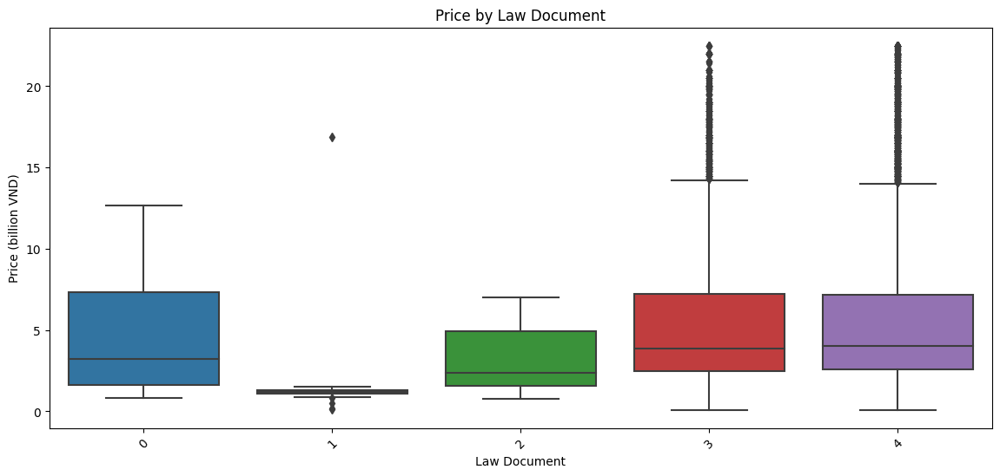

In [22]:
# Count plot for Law Document types
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='Law Document')
plt.title('Law Document Types')
plt.xticks(rotation=45)
plt.show()

# Relationship between Law Document and Price
plt.figure(figsize=(14, 6))
sns.boxplot(data=df, x='Law Document', y='Price (billion VND)')
plt.title('Price by Law Document')
plt.xticks(rotation=45)
plt.show()


Step 10: Importance and Place Rank

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


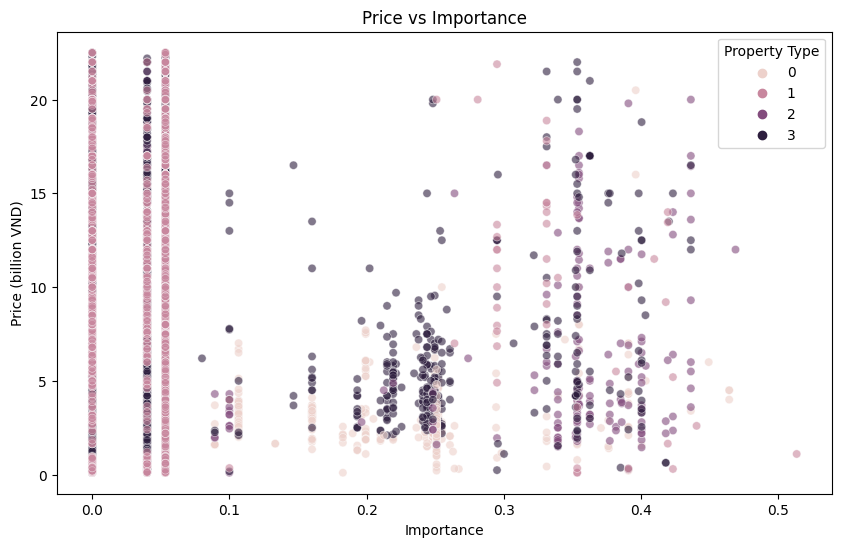

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


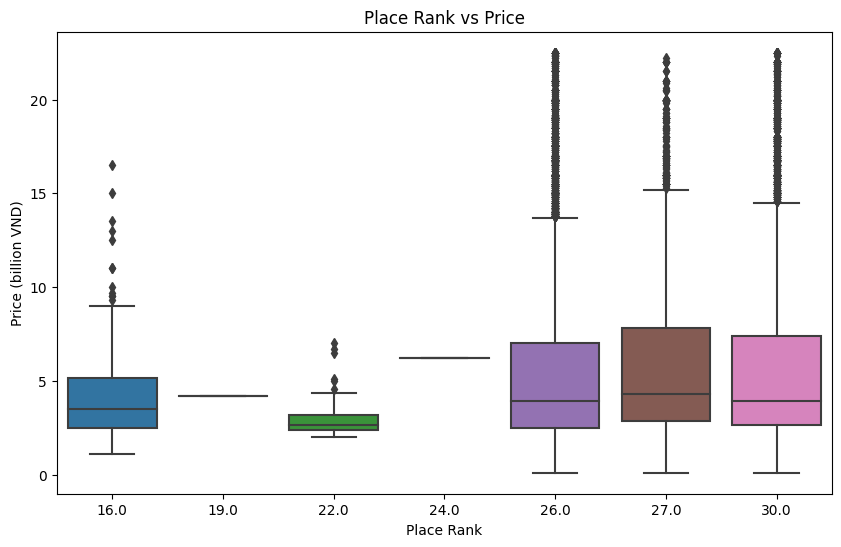

In [23]:
# Plot to observe relationship between Importance and Price
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='Importance', y='Price (billion VND)', hue='Property Type', alpha=0.6)
plt.title('Price vs Importance')
plt.show()

# Place Rank influence on Area
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='Place Rank', y='Price (billion VND)')
plt.title('Place Rank vs Price')
plt.show()


Step 11: City-Level Insights

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


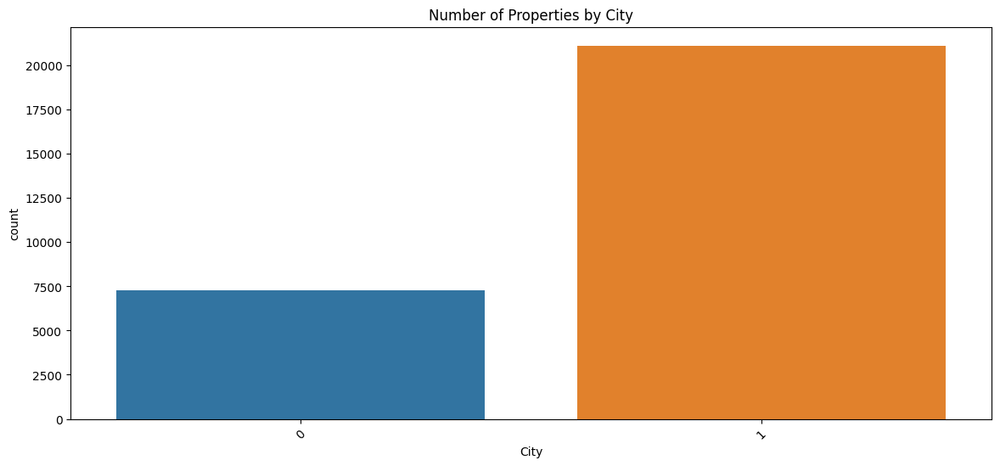

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


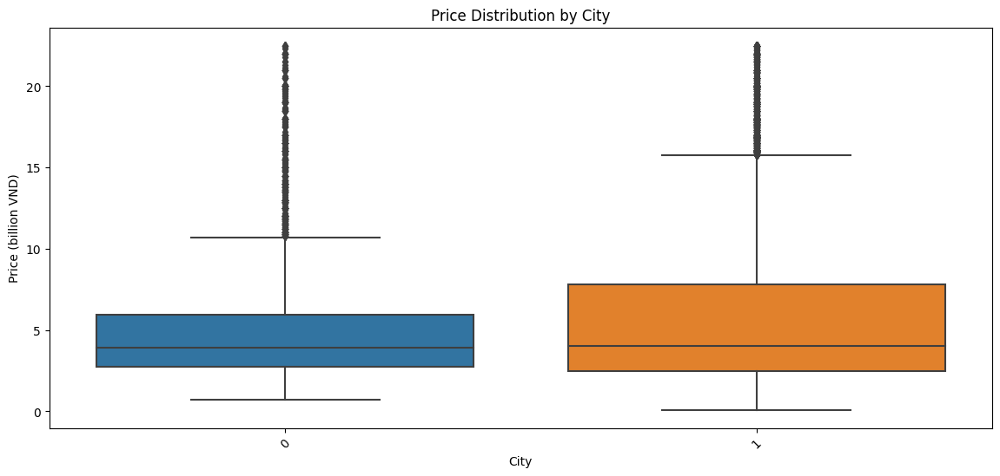

In [24]:
# Property counts by City
plt.figure(figsize=(14, 6))
sns.countplot(data=df, x='City')
plt.title('Number of Properties by City')
plt.xticks(rotation=45)
plt.show()

# Price per City boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df, x='City', y='Price (billion VND)')
plt.title('Price Distribution by City')
plt.xticks(rotation=45)
plt.show()


Step 12: Insights for Bedrooms and Bathrooms

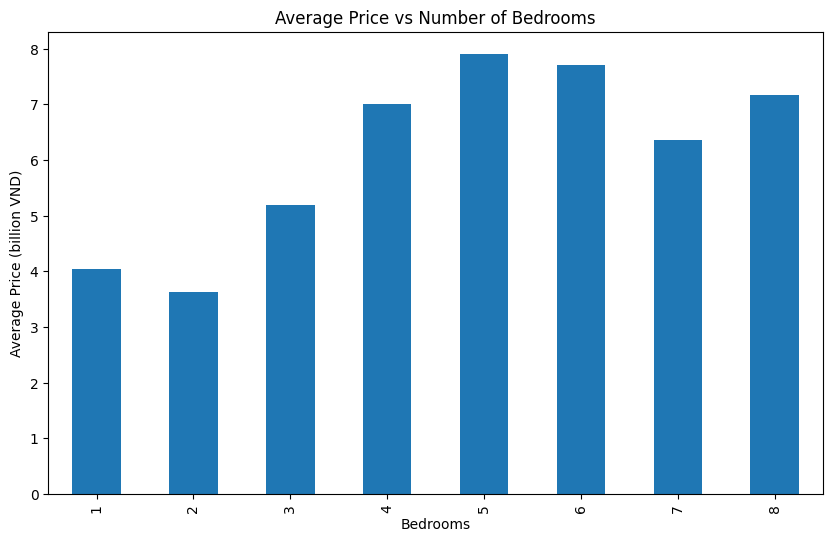

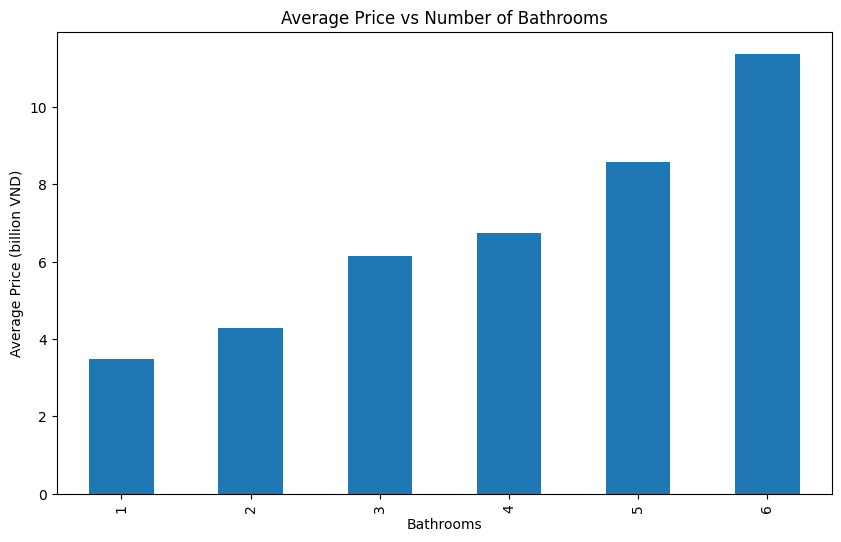

In [25]:
# Average Price vs Number of Bedrooms
bedroom_avg_price = df.groupby('Bedrooms')['Price (billion VND)'].mean()
bedroom_avg_price.plot(kind='bar', figsize=(10, 6))
plt.title('Average Price vs Number of Bedrooms')
plt.xlabel('Bedrooms')
plt.ylabel('Average Price (billion VND)')
plt.show()

# Average Price vs Number of Bathrooms
bathroom_avg_price = df.groupby('Bathrooms')['Price (billion VND)'].mean()
bathroom_avg_price.plot(kind='bar', figsize=(10, 6))
plt.title('Average Price vs Number of Bathrooms')
plt.xlabel('Bathrooms')
plt.ylabel('Average Price (billion VND)')
plt.show()


Step 13: Interaction between Area and Price

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


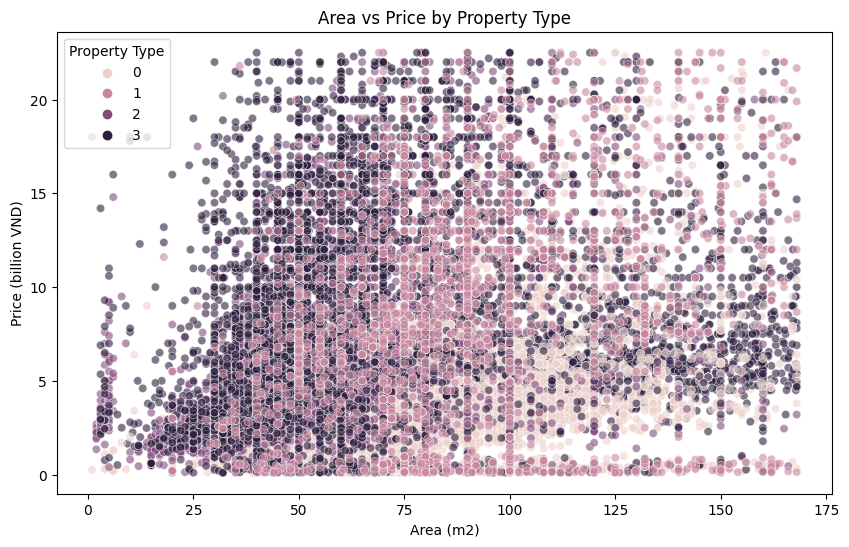

In [26]:
# Scatterplot to see how Price changes with Area
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='Area (m2)', y='Price (billion VND)', hue='Property Type', alpha=0.6)
plt.title('Area vs Price by Property Type')
plt.show()


Pairwise Relationships with Price

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


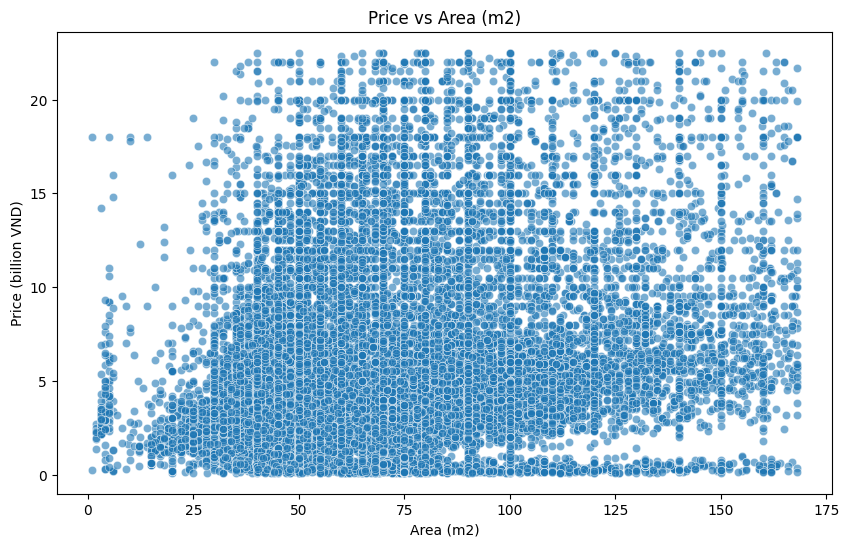

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


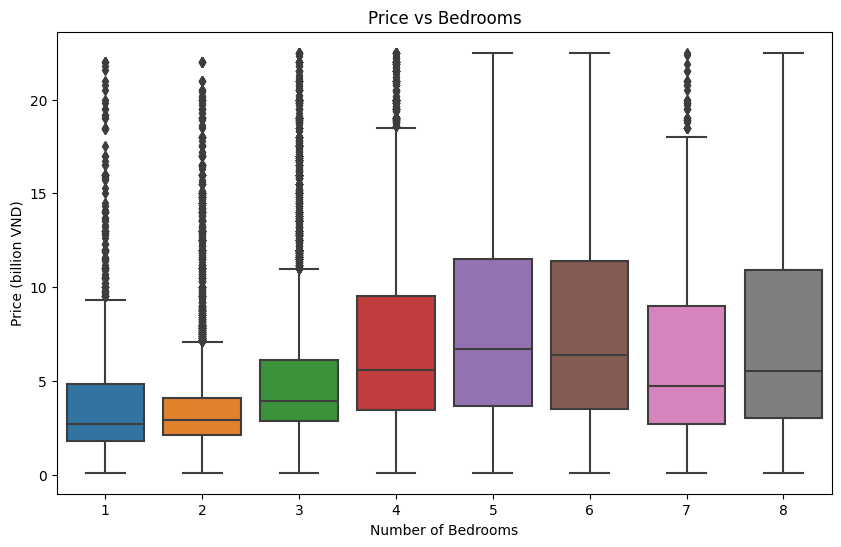

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


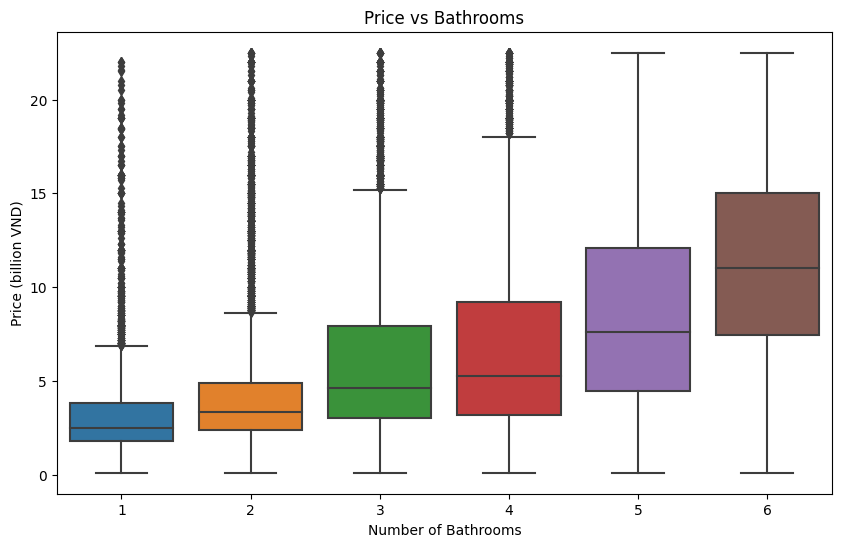

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


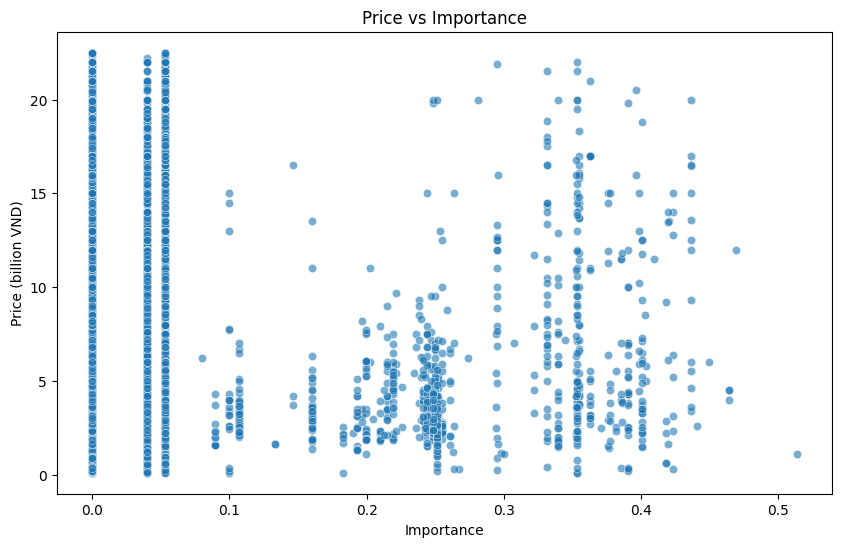

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


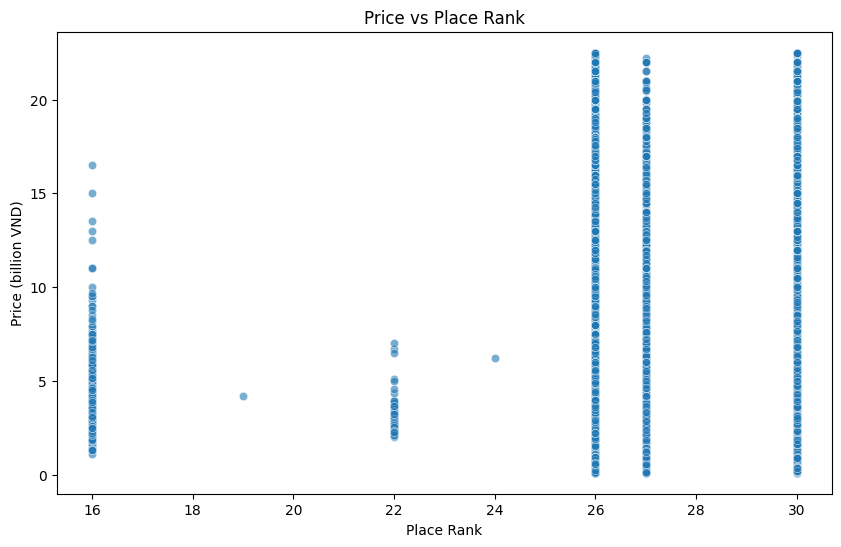

In [27]:


# Scatterplot for Price vs Area (m2)
plt.figure(figsize=(10, 6))
sns.scatterplot(data=filtered_df, x='Area (m2)', y='Price (billion VND)', alpha=0.6)
plt.title('Price vs Area (m2)')
plt.xlabel('Area (m2)')
plt.ylabel('Price (billion VND)')
plt.show()

# Boxplot for Price vs Bedrooms
plt.figure(figsize=(10, 6))
sns.boxplot(data=filtered_df, x='Bedrooms', y='Price (billion VND)')
plt.title('Price vs Bedrooms')
plt.xlabel('Number of Bedrooms')
plt.ylabel('Price (billion VND)')
plt.show()

# Boxplot for Price vs Bathrooms
plt.figure(figsize=(10, 6))
sns.boxplot(data=filtered_df, x='Bathrooms', y='Price (billion VND)')
plt.title('Price vs Bathrooms')
plt.xlabel('Number of Bathrooms')
plt.ylabel('Price (billion VND)')
plt.show()

# Scatterplot for Price vs Importance
plt.figure(figsize=(10, 6))
sns.scatterplot(data=filtered_df, x='Importance', y='Price (billion VND)', alpha=0.6)
plt.title('Price vs Importance')
plt.xlabel('Importance')
plt.ylabel('Price (billion VND)')
plt.show()

# Scatterplot for Price vs Place Rank
plt.figure(figsize=(10, 6))
sns.scatterplot(data=filtered_df, x='Place Rank', y='Price (billion VND)', alpha=0.6)
plt.title('Price vs Place Rank')
plt.xlabel('Place Rank')
plt.ylabel('Price (billion VND)')
plt.show()